In [128]:
import scanpy as sc
import anndata
import logging
import os
import numpy as np
import pandas as pd
import json
# import scanpy.external as sce
logging.basicConfig(level=logging.INFO)

from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

import matplotlib.pyplot as plt
import seaborn as sns
import umap

# from PySpots.fish_helpers import *
from dredFISH.Analysis import basicu
from dredFISH.Analysis import regu
from dredFISH.Analysis import celltypeu
from dredFISH.Analysis import evalu
from dredFISH.Analysis import TissueGraph as tgh

import importlib
importlib.reload(tgh)
importlib.reload(basicu)
importlib.reload(celltypeu)
importlib.reload(evalu)
sc.set_figure_params(figsize=(7, 7))

In [129]:
logging.info('hi')

INFO:root:hi


# file paths and load data

In [3]:
prj_dir = '/bigstore/GeneralStorage/fangming/projects/dredfish/'
dat_dir = prj_dir + 'data/'
res_dir = prj_dir + 'data_dump/'
fig_dir = prj_dir + 'figures/'

input_celltypes = f'{res_dir}noHarmony_March30_v4_isocortex_hpf.csv'
print(input_celltypes)
input_embed1 = f'{res_dir}Joint_UMAP_isocortex_hpf_April1.csv'
print(input_embed1)
input_embed2 = f'{res_dir}Joint_UMAP_isocortex_hpf_subsamp100_level1_April1.csv'
print(input_embed2)
input_embed3 = f'{res_dir}Joint_UMAP_isocortex_hpf_subsamp100_level1_April1_v2.csv'
print(input_embed3)

# dredFISH data
dataset = 'DPNMF_PolyA_2021Nov19' # dataset tag
base_path = '/bigstore/Images2021/gaby/dredFISH/DPNMF_PolyA_2021Nov19/'
fish_path = f'{base_path}fishdata_2022Mar23/' # Zach's new version
# anndata_path = f'{base_path}results/raw_fishdata_Mar30.h5ad'
anndata_path = '/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/DPNMF_PolyA_2021Nov19_v2_results_anndata.h5ad'
# anndata_path = ''

# allen data
scrna_path = '/bigstore/GeneralStorage/fangming/projects/dredfish/data/rna/scrna_ss_ctxhippo_a_exon_DPNMF_matrix.h5ad'

# allen tree
allen_tree_path='/bigstore/GeneralStorage/fangming/reference/allen_ccf/structures.json'


# analysis metadata
meta_path = '/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/analysis_meta_Mar31.json'


/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/noHarmony_March30_v4_isocortex_hpf.csv
/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/Joint_UMAP_isocortex_hpf_April1.csv
/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/Joint_UMAP_isocortex_hpf_subsamp100_level1_April1.csv
/bigstore/GeneralStorage/fangming/projects/dredfish/data_dump/Joint_UMAP_isocortex_hpf_subsamp100_level1_April1_v2.csv


In [4]:
%%time

# load dredFISH
TMG = tgh.TissueMultiGraph(name=dataset)
# load raw counts data
if os.path.isfile(anndata_path):
    print('from AnnData')
    TMG.load_from_anndata(anndata_path)
else:
    print('from FishData')
    TMG.load_from_fishdata(fish_path, dataset, output_path=anndata_path)
# normalize (optional for spatial registration)
TMG.normalize_data(norm_cell=True, norm_bit=False)

### for now
data = TMG.data

# print(data)
    
# allen scrna matrix
ref_data = anndata.read_h5ad(scrna_path)
# print(ref_data)

# allen tree
allen_tree, allen_maps = regu.load_allen_tree(allen_tree_path)

# analysis
with open(meta_path, 'r') as fh:
    meta = json.load(fh)


from AnnData


INFO:root:113758 cells, minimum counts = 1248.0


CPU times: user 547 ms, sys: 573 ms, total: 1.12 s
Wall time: 1.56 s


In [5]:
ref_data.obs = ref_data.obs.rename({
                                    'class_label': 'Level_1_class_label',
                                    'neighborhood_label': 'Level_2_neighborhood_label',
                                    'subclass_label': 'Level_3_subclass_label',
                                    'cluster_label': 'Level_5_cluster_label',
                                    }, axis=1)
ref_data

AnnData object with n_obs × n_vars = 73347 × 24
    obs: 'donor_sex_id', 'donor_sex_label', 'donor_sex_color', 'region_id', 'region_label', 'region_color', 'platform_label', 'cluster_order', 'Level_5_cluster_label', 'cluster_color', 'subclass_order', 'Level_3_subclass_label', 'subclass_color', 'neighborhood_id', 'Level_2_neighborhood_label', 'neighborhood_color', 'class_order', 'Level_1_class_label', 'class_color', 'exp_component_name', 'external_donor_name_label', 'full_genotype_label', 'facs_population_plan_label', 'injection_roi_label', 'injection_materials_label', 'injection_method_label', 'injection_type_label', 'full_genotype_id', 'full_genotype_color', 'external_donor_name_id', 'external_donor_name_color', 'facs_population_plan_id', 'facs_population_plan_color', 'injection_materials_id', 'injection_materials_color', 'injection_method_id', 'injection_method_color', 'injection_roi_id', 'injection_roi_color', 'injection_type_id', 'injection_type_color', 'cell_type_accession_label',

In [6]:
# select specific regions
selected_regions = ['Isocortex', 'HPF']
selected_all_sids = regu.expand_regions(allen_tree, selected_regions, 'acronym')

# selected cells
cond_cells = data.obs['region_id'].isin(selected_all_sids)
data = data[cond_cells]
data

View of AnnData object with n_obs × n_vars = 44075 × 24
    obs: 'label', 'pixel_x', 'pixel_y', 'nuclei_size', 'nuclei_signal', 'cytoplasm_size', 'cytoplasm_signal', 'total_size', 'total_signal', 'posname', 'posname_stage_x', 'posname_stage_y', 'cell_name', 'stage_x', 'stage_y', 'coord_x', 'coord_y', 'region_id', 'region_color', 'region_acronym'
    obsm: 'stage'
    layers: 'cytoplasm_vectors', 'nuclei_vectors', 'total_vectors', 'norm_cell'

In [7]:
# results
dftypes = pd.read_csv(input_celltypes, index_col=0)
dftypes = dftypes.filter(regex=r'^Level_[0-9]', axis=1)
levels = dftypes.columns.values

# update data
data.obs = data.obs.join(dftypes)

# update the joint one
dfembed1 = pd.read_csv(input_embed1, index_col=0)
dfembed2 = pd.read_csv(input_embed2, index_col=0)
dfembed3 = pd.read_csv(input_embed3, index_col=0)
dfembed1 = dfembed1.join(pd.concat([data.obs, ref_data.obs]))
dfembed2 = dfembed2.join(pd.concat([data.obs, ref_data.obs]))
dfembed3 = dfembed3.join(pd.concat([data.obs, ref_data.obs]))

print(dftypes.shape, dfembed1.shape, dfembed2.shape, dfembed3.shape, data.obs.shape)

(44075, 3) (117422, 79) (44375, 79) (44375, 79) (44075, 23)


# Organize information

In [15]:
def plot_highlight(ax, df, col, catg, color):
    """
    """
    cond = (df[col] == catg)
    sns.scatterplot(
        data=df, 
        x='embed_1',
        y='embed_2',
        # hue='Level_1_class_label',
        color='lightgray',
        edgecolor='none',
        s=1,
        ax=ax,
    )
    sns.scatterplot(
        data=df[cond], 
        x='embed_1',
        y='embed_2',
        # hue='Level_1_class_label',
        color=color,
        edgecolor='none',
        s=3,
        ax=ax,
    )
    ax.set_aspect('equal')
    sns.despine(ax=ax)
    ax.set_xticks([])
    ax.set_yticks([])

    ax.set_title(catg)
    
def plot_highlight_hue(ax, df, col, catg, hue):
    """
    """
    cond = (df[col] == catg)
    sns.scatterplot(
        data=df, 
        x='embed_1',
        y='embed_2',
        # hue='Level_1_class_label',
        color='lightgray',
        edgecolor='none',
        s=1,
        ax=ax,
    )
    
    hue_order = np.sort(np.unique(df[cond][hue]))
    nums = len(hue_order) 
    sns.scatterplot(
        data=df[cond], 
        x='embed_1',
        y='embed_2',
        hue=hue,
        hue_order=hue_order,
        # color=color,
        edgecolor='none',
        s=3,
        ax=ax,
    )
    ax.set_aspect('equal')
    sns.despine(ax=ax)
    ax.set_xticks([])
    ax.set_yticks([])

    ax.set_title(catg)
    ax.legend(bbox_to_anchor=(0,0), loc='upper left', ncol=1+int(nums/10))

In [130]:
res = evalu.Level3Res(meta, levels, 
                ref_data, data, 
                refdata_name='scRNA-seq', data_name='dredFISH',
                embed=True, df_embed=dfembed1,
               )

# # embed eval
# res.plot_embeds(hues=['dataset']+levels[:2].tolist())

# # gene eval
# res.plot_genes()

# # spatial eval
# res.plot_spatial()


# get per-bit information 

In [189]:
dfplot = dfembed1.copy()
assert np.all(dfembed1.index.values == np.hstack([res.refdata.obs.index, res.data.obs.index]))
normX, _, _ = res.get_cell_level(mode='X', reorder_bits=False)
normY, _, _ = res.get_cell_level(mode='Y', reorder_bits=False)
normXY = np.vstack([normX, normY])

for i in np.arange(24): 
    dfplot[f'bit{i}'] = normXY[:,i]
    
dfplot['bit_maxglia'] = np.max(dfplot[['bit18', 'bit21', 'bit6']].values, axis=1)
dfplot['bit_meanglia'] = np.mean(dfplot[['bit18', 'bit21', 'bit6']].values, axis=1)
dfplot['bit_medianglia'] = np.median(dfplot[['bit18', 'bit21', 'bit6']].values, axis=1)

/tmp/ipykernel_2492363/2812053094.py:18: MatplotlibDeprecationWarning:

Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.



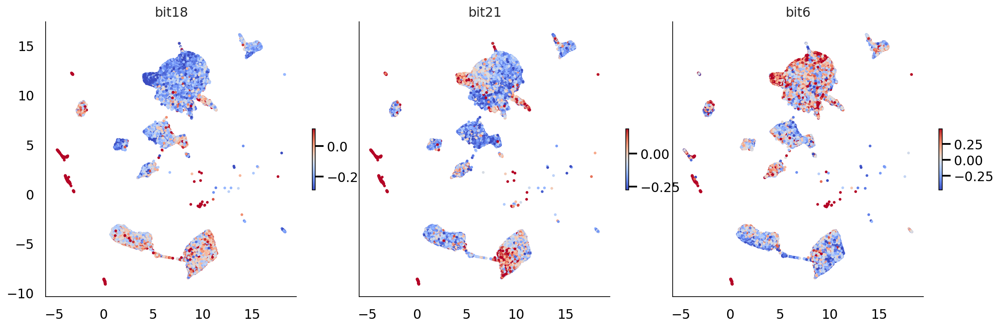

In [190]:
df = dfplot
cond = df['dataset']=='scRNA-seq'
df = df[cond]

fig, axs = plt.subplots(1,3, figsize=(6*3, 6), sharex=True, sharey=True)
for ax, bit in zip(axs, meta['l3_bits'][-3:]):
    hue_col = f'bit{bit}'
    g = ax.scatter(df['embed_1'].values, 
               df['embed_2'].values,
               c=basicu.clip_by_percentile(df[hue_col].values),
               cmap='coolwarm',
               s=2,
              )
    ax.set_title(hue_col)
    ax.grid(False)
    sns.despine(ax=ax)
    ax.set_aspect('equal')
    fig.colorbar(g, ax=ax, shrink=0.2)

# ax = axs[1]
# evalu.plot_embed(ax, df[cond], 'bit18')
# # plot_highlight(ax, df, 'dataset', 'dredFISH', 'C0')
# # ax = axs[2]
# # plot_highlight(ax, df, 'dataset', 'scRNA-seq', 'C1')
fig.subplots_adjust(wspace=0)
plt.show()

/tmp/ipykernel_2492363/4051786650.py:22: MatplotlibDeprecationWarning:

Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.



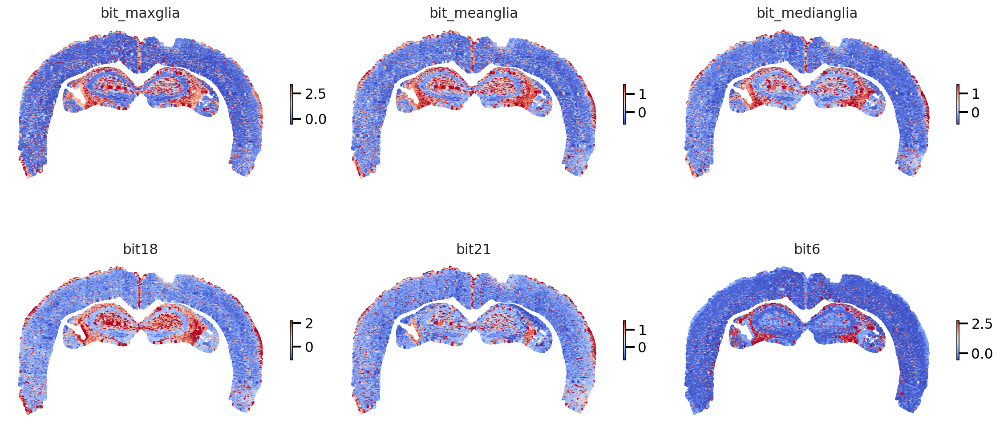

In [191]:
df = dfplot
cond = df['dataset']=='dredFISH'
df = df[cond]
# hue_cols = ['bit18', 'bit21', 'bit6', 'bit_nonneu']
hue_cols = ['bit_maxglia', 'bit_meanglia', 'bit_medianglia', 
            'bit18', 'bit21', 'bit6',
           ]

fig, axs = plt.subplots(2,3, figsize=(6*3, 4*2))
for ax, hue_col in zip(axs.flat, hue_cols):
    g = ax.scatter(df['coord_x'].values, 
               df['coord_y'].values,
               c=basicu.clip_by_percentile(df[hue_col].values),
               cmap='coolwarm',
               s=2,
              )
    ax.set_title(hue_col)
    ax.grid(False)
    ax.axis('off')
    ax.invert_yaxis()
    ax.set_aspect('equal')
    fig.colorbar(g, ax=ax, shrink=0.2)

fig.subplots_adjust(wspace=0)
plt.show()

/tmp/ipykernel_2492363/2195637443.py:21: MatplotlibDeprecationWarning:

Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.



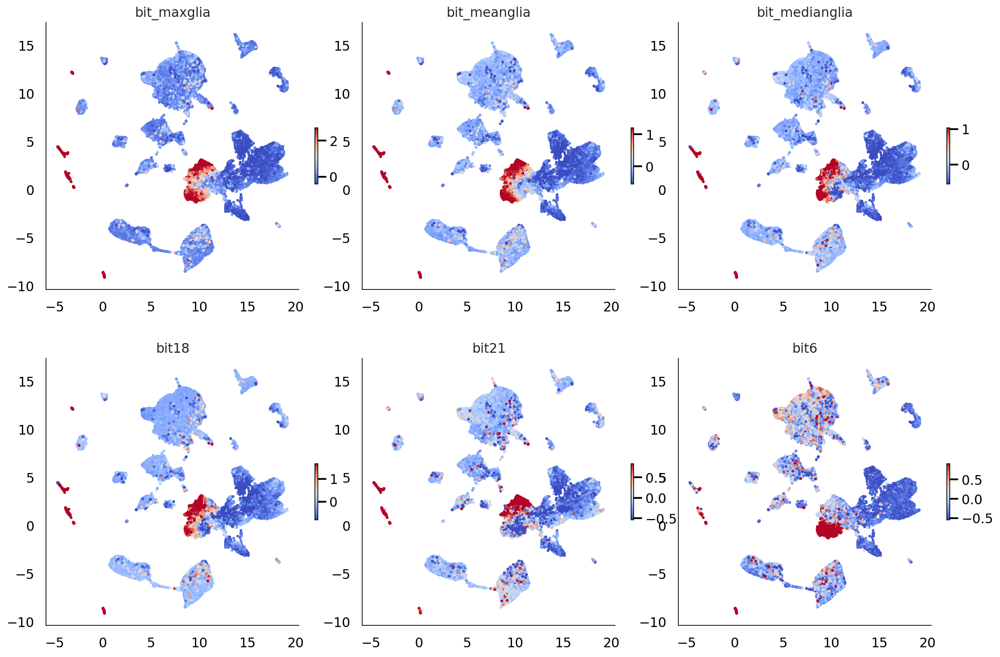

In [192]:

df = dfplot
# cond = df['dataset']=='dredFISH'
# df = df[cond]
# hue_cols = ['bit18', 'bit21', 'bit6', 'bit_nonneu']
hue_cols = ['bit_maxglia', 'bit_meanglia', 'bit_medianglia', 
            'bit18', 'bit21', 'bit6',
           ]

fig, axs = plt.subplots(2,3, figsize=(6*3, 6*2))
for ax, hue_col in zip(axs.flat, hue_cols):
    g = ax.scatter(df['embed_1'].values, 
               df['embed_2'].values,
               c=basicu.clip_by_percentile(df[hue_col].values),
               cmap='coolwarm',
               s=2,
              )
    ax.set_title(hue_col)
    ax.grid(False)
    sns.despine(ax=ax)
    ax.set_aspect('equal')
    fig.colorbar(g, ax=ax, shrink=0.2)

# ax = axs[1]
# evalu.plot_embed(ax, df[cond], 'bit18')
# # plot_highlight(ax, df, 'dataset', 'dredFISH', 'C0')
# # ax = axs[2]
# # plot_highlight(ax, df, 'dataset', 'scRNA-seq', 'C1')
fig.subplots_adjust(wspace=0)
plt.show()

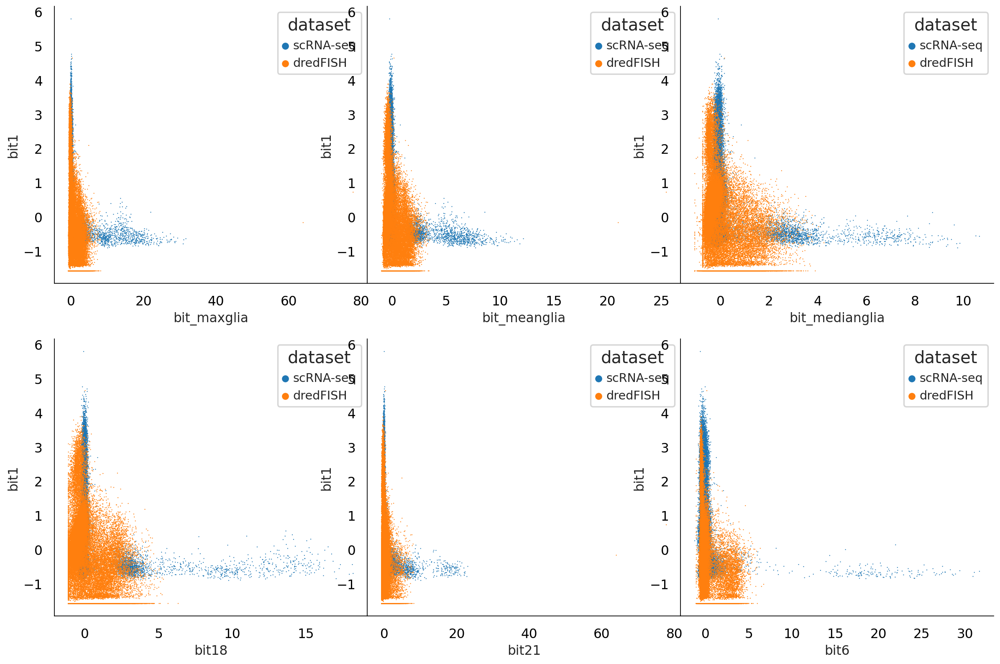

In [193]:

df = dfplot
x_cols = ['bit_maxglia', 'bit_meanglia', 'bit_medianglia', 
            'bit18', 'bit21', 'bit6',
           ]

fig, axs = plt.subplots(2,3, figsize=(6*3, 6*2))
for ax, x_col in zip(axs.flat, x_cols):
    sns.scatterplot(data=df,
                    x=x_col, 
                    y='bit1',
                    hue='dataset',
                    edgecolor='none',
                    s=1,
                    ax=ax,
                   )
    ax.grid(False)
    sns.despine(ax=ax)
fig.subplots_adjust(wspace=0)
plt.show()

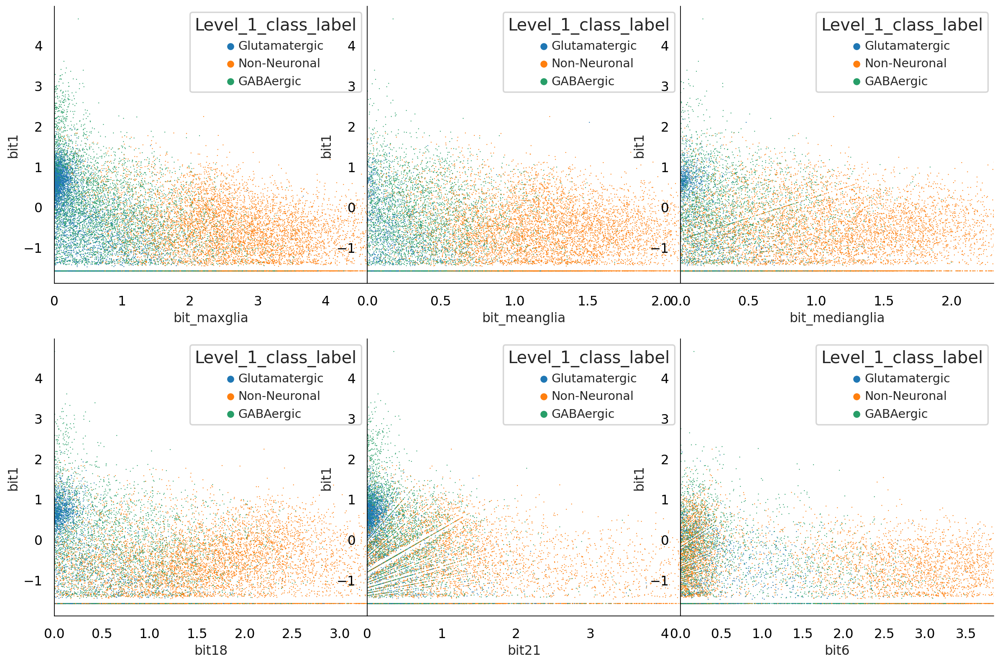

In [194]:
df = dfplot
cond = df['dataset']=='dredFISH'
df = df[cond]
x_cols = ['bit_maxglia', 'bit_meanglia', 'bit_medianglia', 
            'bit18', 'bit21', 'bit6',
           ]

fig, axs = plt.subplots(2,3, figsize=(6*3, 6*2))
for ax, x_col in zip(axs.flat, x_cols):
    sns.scatterplot(data=df,
                    x=x_col, 
                    y='bit1',
                    hue='Level_1_class_label',
                    edgecolor='none',
                    s=1,
                    ax=ax,
                   )
    ax.grid(False)
    sns.despine(ax=ax)
    hi_val = np.percentile(df[x_col].values, 99)
    ax.set_xlim([0, hi_val])
fig.subplots_adjust(wspace=0)
plt.show()

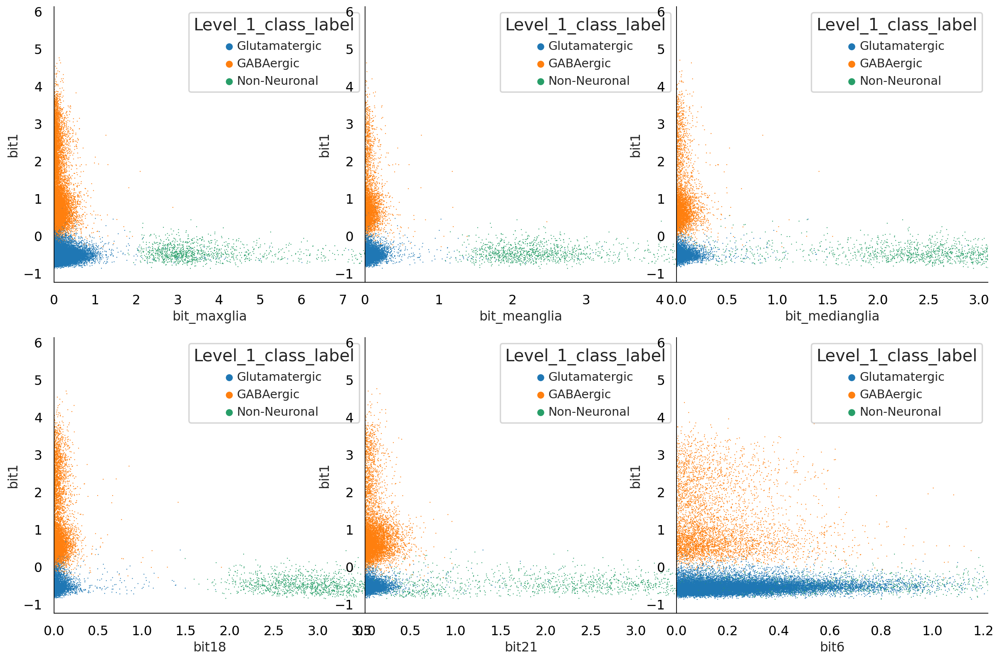

In [195]:
df = dfplot
cond = df['dataset']=='scRNA-seq'
df = df[cond]
x_cols = ['bit_maxglia', 'bit_meanglia', 'bit_medianglia', 
            'bit18', 'bit21', 'bit6',
           ]

fig, axs = plt.subplots(2,3, figsize=(6*3, 6*2))
for ax, x_col in zip(axs.flat, x_cols):
    sns.scatterplot(data=df,
                    x=x_col, 
                    y='bit1',
                    hue='Level_1_class_label',
                    edgecolor='none',
                    s=1,
                    ax=ax,
                   )
    ax.grid(False)
    sns.despine(ax=ax)
    hi_val = np.percentile(df[x_col].values, 99)
    ax.set_xlim([0, hi_val])
fig.subplots_adjust(wspace=0)
plt.show()

# get per-bit information (un-normed by bits)

In [154]:
dfplot = dfembed1.copy()
assert np.all(dfembed1.index.values == np.hstack([res.refdata.obs.index, res.data.obs.index]))
normX, _, _ = res.get_cell_level(mode='X', norm_bits=False, reorder_bits=False)
normY, _, _ = res.get_cell_level(mode='Y', norm_bits=False, reorder_bits=False)
normX = normX/normX.sum(axis=1).reshape(-1,1)
normY = normY/normY.sum(axis=1).reshape(-1,1)
normXY = np.vstack([normX, normY])

for i in np.arange(24): 
    dfplot[f'bit{i}'] = normXY[:,i]
    
dfplot['bit_maxglia'] = np.max(dfplot[['bit18', 'bit21', 'bit6']].values, axis=1)
dfplot['bit_meanglia'] = np.mean(dfplot[['bit18', 'bit21', 'bit6']].values, axis=1)
dfplot['bit_medianglia'] = np.median(dfplot[['bit18', 'bit21', 'bit6']].values, axis=1)

/tmp/ipykernel_2492363/2812053094.py:18: MatplotlibDeprecationWarning:

Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.



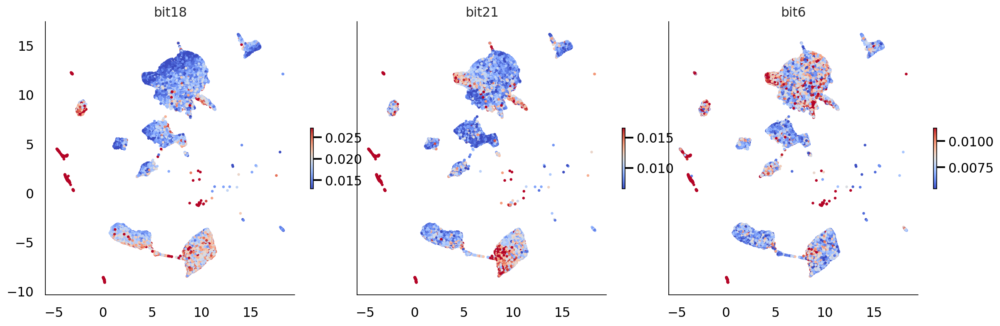

In [155]:
df = dfplot
cond = df['dataset']=='scRNA-seq'
df = df[cond]

fig, axs = plt.subplots(1,3, figsize=(6*3, 6), sharex=True, sharey=True)
for ax, bit in zip(axs, meta['l3_bits'][-3:]):
    hue_col = f'bit{bit}'
    g = ax.scatter(df['embed_1'].values, 
               df['embed_2'].values,
               c=basicu.clip_by_percentile(df[hue_col].values),
               cmap='coolwarm',
               s=2,
              )
    ax.set_title(hue_col)
    ax.grid(False)
    sns.despine(ax=ax)
    ax.set_aspect('equal')
    fig.colorbar(g, ax=ax, shrink=0.2)

# ax = axs[1]
# evalu.plot_embed(ax, df[cond], 'bit18')
# # plot_highlight(ax, df, 'dataset', 'dredFISH', 'C0')
# # ax = axs[2]
# # plot_highlight(ax, df, 'dataset', 'scRNA-seq', 'C1')
fig.subplots_adjust(wspace=0)
plt.show()

/tmp/ipykernel_2492363/4051786650.py:22: MatplotlibDeprecationWarning:

Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.



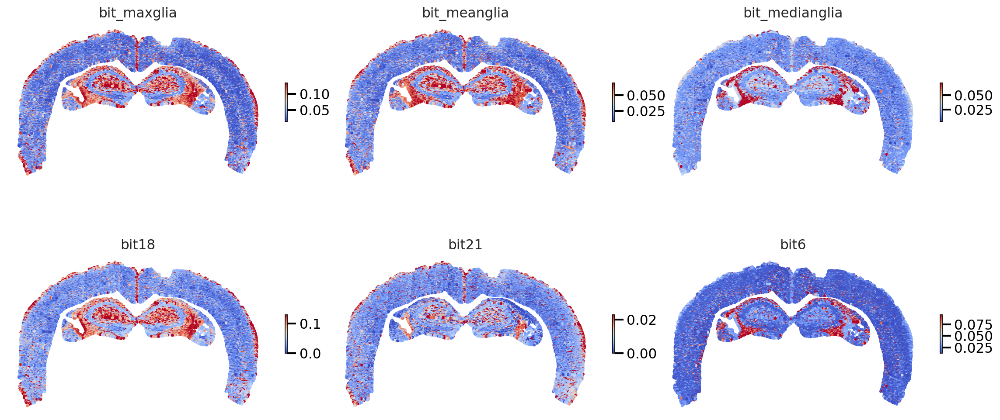

In [156]:
df = dfplot
cond = df['dataset']=='dredFISH'
df = df[cond]
# hue_cols = ['bit18', 'bit21', 'bit6', 'bit_nonneu']
hue_cols = ['bit_maxglia', 'bit_meanglia', 'bit_medianglia', 
            'bit18', 'bit21', 'bit6',
           ]

fig, axs = plt.subplots(2,3, figsize=(6*3, 4*2))
for ax, hue_col in zip(axs.flat, hue_cols):
    g = ax.scatter(df['coord_x'].values, 
               df['coord_y'].values,
               c=basicu.clip_by_percentile(df[hue_col].values),
               cmap='coolwarm',
               s=2,
              )
    ax.set_title(hue_col)
    ax.grid(False)
    ax.axis('off')
    ax.invert_yaxis()
    ax.set_aspect('equal')
    fig.colorbar(g, ax=ax, shrink=0.2)

fig.subplots_adjust(wspace=0)
plt.show()

/tmp/ipykernel_2492363/2195637443.py:21: MatplotlibDeprecationWarning:

Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.



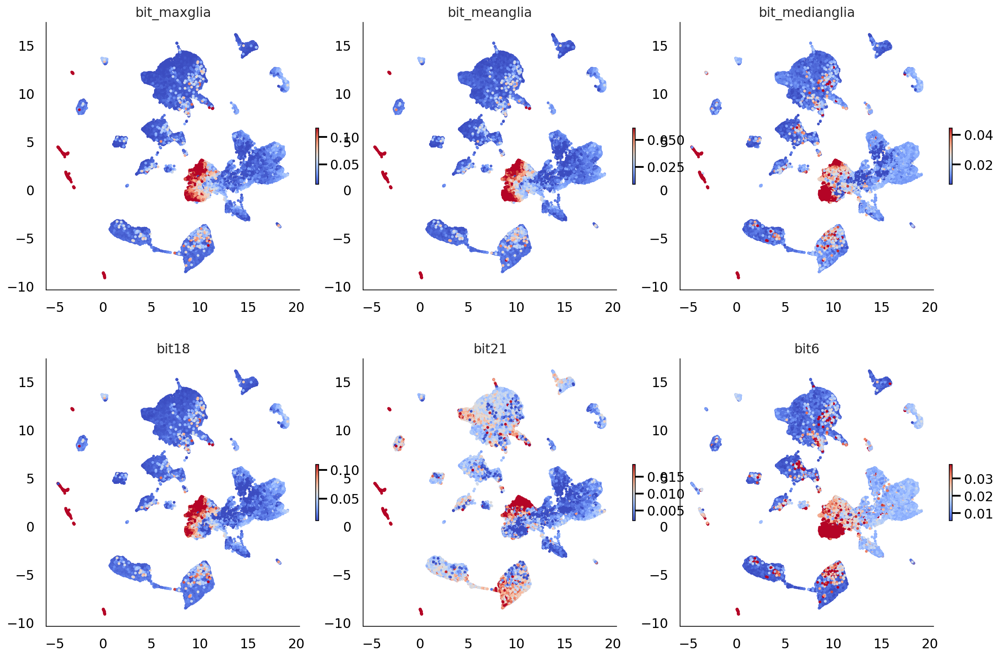

In [157]:

df = dfplot
# cond = df['dataset']=='dredFISH'
# df = df[cond]
# hue_cols = ['bit18', 'bit21', 'bit6', 'bit_nonneu']
hue_cols = ['bit_maxglia', 'bit_meanglia', 'bit_medianglia', 
            'bit18', 'bit21', 'bit6',
           ]

fig, axs = plt.subplots(2,3, figsize=(6*3, 6*2))
for ax, hue_col in zip(axs.flat, hue_cols):
    g = ax.scatter(df['embed_1'].values, 
               df['embed_2'].values,
               c=basicu.clip_by_percentile(df[hue_col].values),
               cmap='coolwarm',
               s=2,
              )
    ax.set_title(hue_col)
    ax.grid(False)
    sns.despine(ax=ax)
    ax.set_aspect('equal')
    fig.colorbar(g, ax=ax, shrink=0.2)

# ax = axs[1]
# evalu.plot_embed(ax, df[cond], 'bit18')
# # plot_highlight(ax, df, 'dataset', 'dredFISH', 'C0')
# # ax = axs[2]
# # plot_highlight(ax, df, 'dataset', 'scRNA-seq', 'C1')
fig.subplots_adjust(wspace=0)
plt.show()

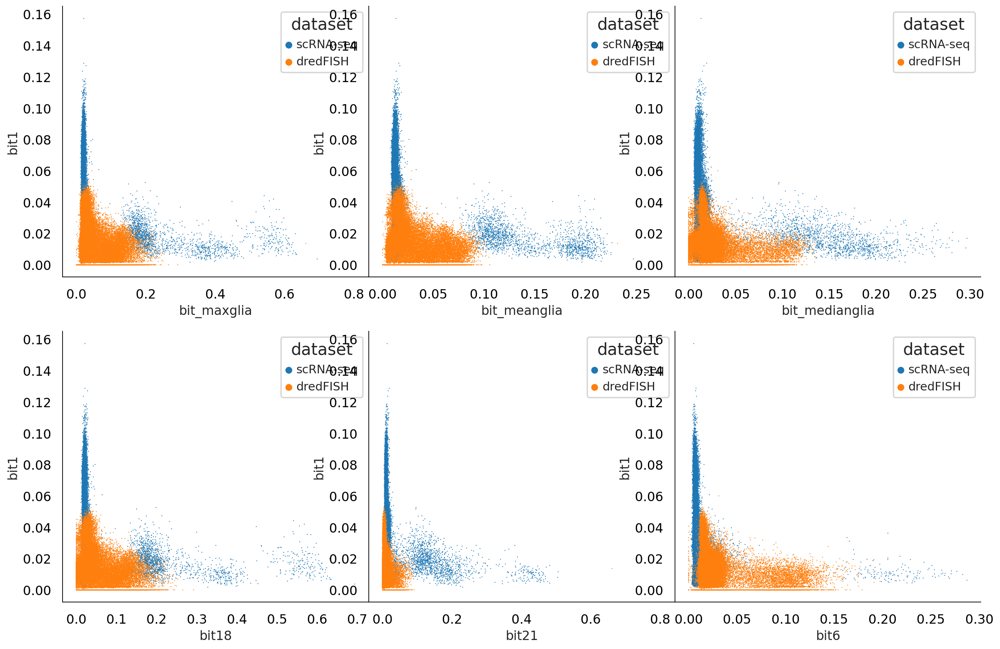

In [159]:

df = dfplot
# cond = df['dataset']=='dredFISH'
# df = df[cond]
x_cols = ['bit_maxglia', 'bit_meanglia', 'bit_medianglia', 
            'bit18', 'bit21', 'bit6',
           ]

fig, axs = plt.subplots(2,3, figsize=(6*3, 6*2))
for ax, x_col in zip(axs.flat, x_cols):
    sns.scatterplot(data=df,
                    x=x_col, 
                    y='bit1',
                    hue='dataset',
                    edgecolor='none',
                    s=1,
                    ax=ax,
                   )
    ax.grid(False)
    sns.despine(ax=ax)
fig.subplots_adjust(wspace=0)
plt.show()

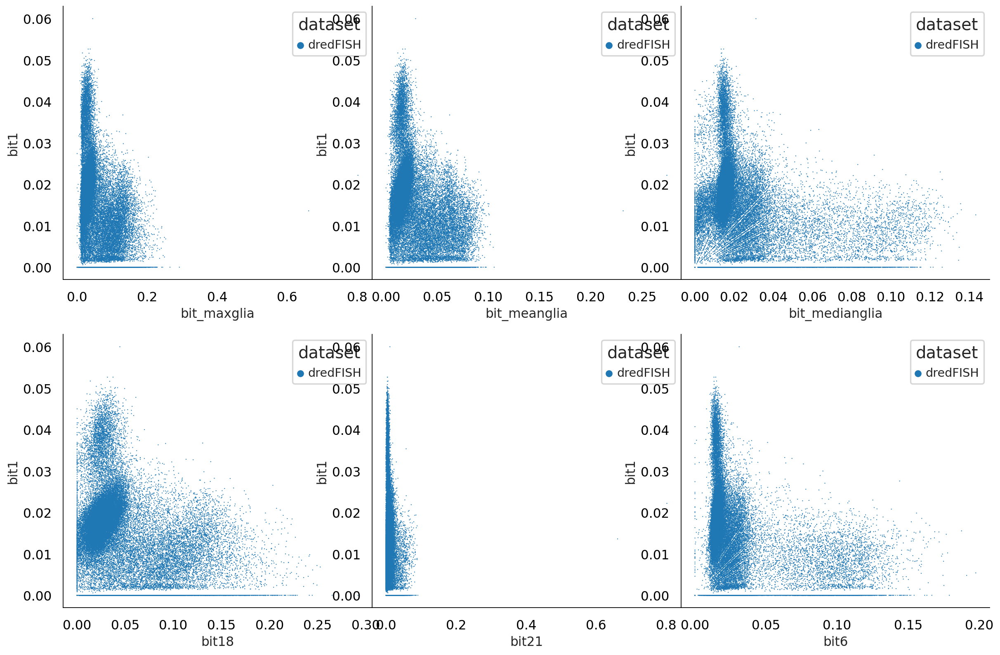

In [160]:

df = dfplot
cond = df['dataset']=='dredFISH'
df = df[cond]
x_cols = ['bit_maxglia', 'bit_meanglia', 'bit_medianglia', 
            'bit18', 'bit21', 'bit6',
           ]

fig, axs = plt.subplots(2,3, figsize=(6*3, 6*2))
for ax, x_col in zip(axs.flat, x_cols):
    sns.scatterplot(data=df,
                    x=x_col, 
                    y='bit1',
                    hue='dataset',
                    edgecolor='none',
                    s=1,
                    ax=ax,
                   )
    ax.grid(False)
    sns.despine(ax=ax)
fig.subplots_adjust(wspace=0)
plt.show()

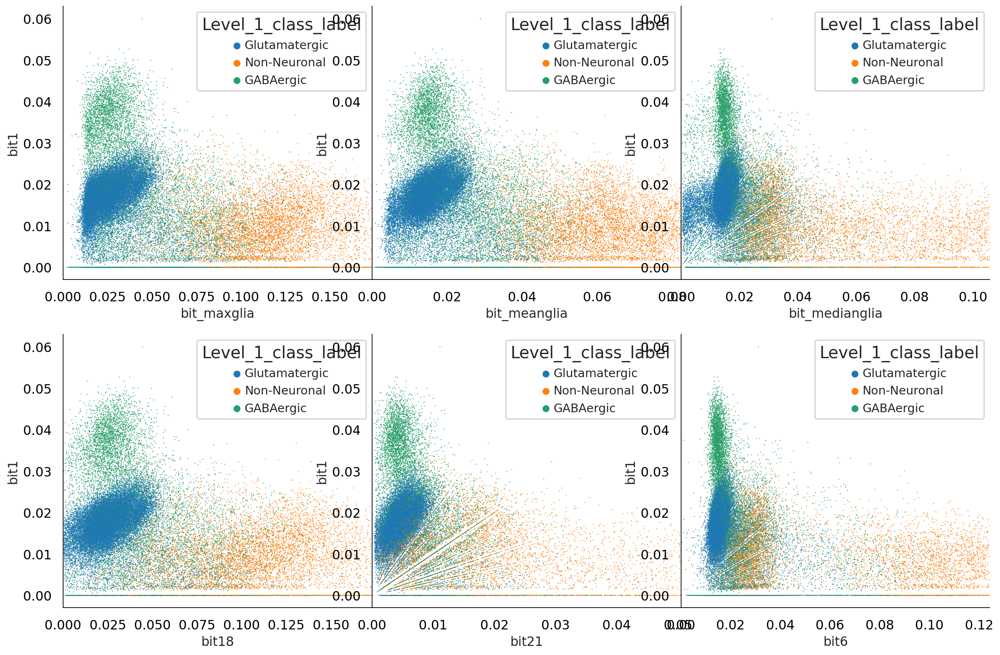

In [187]:
df = dfplot
cond = df['dataset']=='dredFISH'
df = df[cond]
x_cols = ['bit_maxglia', 'bit_meanglia', 'bit_medianglia', 
            'bit18', 'bit21', 'bit6',
           ]

fig, axs = plt.subplots(2,3, figsize=(6*3, 6*2))
for ax, x_col in zip(axs.flat, x_cols):
    sns.scatterplot(data=df,
                    x=x_col, 
                    y='bit1',
                    hue='Level_1_class_label',
                    edgecolor='none',
                    s=1,
                    ax=ax,
                   )
    ax.grid(False)
    sns.despine(ax=ax)
    hi_val = np.percentile(df[x_col].values, 99)
    ax.set_xlim([0, hi_val])
fig.subplots_adjust(wspace=0)
plt.show()

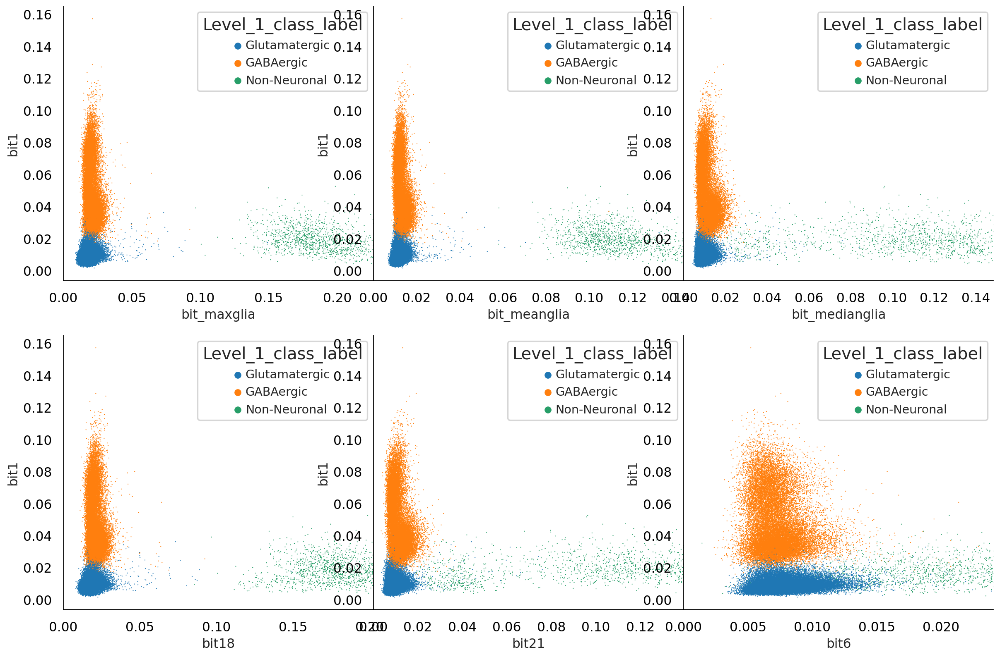

In [188]:
df = dfplot
cond = df['dataset']=='scRNA-seq'
df = df[cond]
x_cols = ['bit_maxglia', 'bit_meanglia', 'bit_medianglia', 
            'bit18', 'bit21', 'bit6',
           ]

fig, axs = plt.subplots(2,3, figsize=(6*3, 6*2))
for ax, x_col in zip(axs.flat, x_cols):
    sns.scatterplot(data=df,
                    x=x_col, 
                    y='bit1',
                    hue='Level_1_class_label',
                    edgecolor='none',
                    s=1,
                    ax=ax,
                   )
    ax.grid(False)
    sns.despine(ax=ax)
    hi_val = np.percentile(df[x_col].values, 99)
    ax.set_xlim([0, hi_val])
fig.subplots_adjust(wspace=0)
plt.show()

# check total vector

In [169]:
# dfplot = dfembed1.copy()
# assert np.all(dfembed1.index.values == np.hstack([res.refdata.obs.index, res.data.obs.index]))
# normX, _, _ = res.get_cell_level(mode='X', norm_bits=False, reorder_bits=False)
# normY, _, _ = res.get_cell_level(mode='Y', norm_bits=False, reorder_bits=False)
# normX = normX/normX.sum(axis=1).reshape(-1,1)
# normY = normY/normY.sum(axis=1).reshape(-1,1)
# normXY = np.vstack([normX, normY])

# for i in np.arange(24): 
#     dfplot[f'bit{i}'] = normXY[:,i]
    
# dfplot['bit_maxglia'] = np.max(dfplot[['bit18', 'bit21', 'bit6']].values, axis=1)
# dfplot['bit_meanglia'] = np.mean(dfplot[['bit18', 'bit21', 'bit6']].values, axis=1)
# dfplot['bit_medianglia'] = np.median(dfplot[['bit18', 'bit21', 'bit6']].values, axis=1)
res.data.obs['total_signal']
dfplot['total_signal']

US-1250273_E1_S37                               NaN
US-1250273_E2_S01                               NaN
US-1250273_E2_S02                               NaN
US-1250273_E2_S03                               NaN
US-1250273_E2_S04                               NaN
                                             ...   
DPNMF_PolyA_2021Nov19_Pos102_cell_1351.0     7888.0
DPNMF_PolyA_2021Nov19_Pos102_cell_1352.0     7248.0
DPNMF_PolyA_2021Nov19_Pos102_cell_1353.0     4560.0
DPNMF_PolyA_2021Nov19_Pos102_cell_1356.0     9184.0
DPNMF_PolyA_2021Nov19_Pos102_cell_1358.0    43760.0
Name: total_signal, Length: 117422, dtype: float64

/tmp/ipykernel_2492363/1993042951.py:22: MatplotlibDeprecationWarning:

Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.



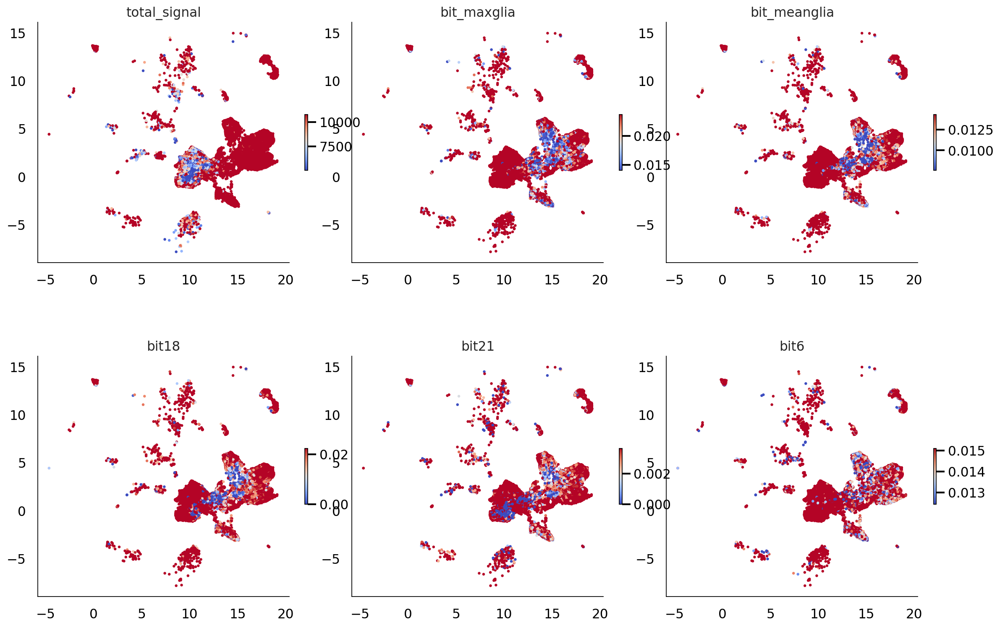

In [183]:

df = dfplot
cond = df['dataset']=='dredFISH'
df = df[cond]
hue_cols = [
            'total_signal', 'bit_maxglia', 'bit_meanglia', 
            'bit18', 'bit21', 'bit6',
           
           ]

fig, axs = plt.subplots(2,3, figsize=(6*3, 6*2))
for ax, hue_col in zip(axs.flat, hue_cols):
    g = ax.scatter(df['embed_1'].values, 
               df['embed_2'].values,
               c=basicu.clip_by_percentile(np.nan_to_num(df[hue_col].values, 0), high_p=30),
               cmap='coolwarm',
               s=2,
              )
    ax.set_title(hue_col)
    ax.grid(False)
    sns.despine(ax=ax)
    ax.set_aspect('equal')
    fig.colorbar(g, ax=ax, shrink=0.2)

# ax = axs[1]
# evalu.plot_embed(ax, df[cond], 'bit18')
# # plot_highlight(ax, df, 'dataset', 'dredFISH', 'C0')
# # ax = axs[2]
# # plot_highlight(ax, df, 'dataset', 'scRNA-seq', 'C1')
fig.subplots_adjust(wspace=0)
plt.show()

/tmp/ipykernel_2492363/1874536924.py:23: MatplotlibDeprecationWarning:

Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.



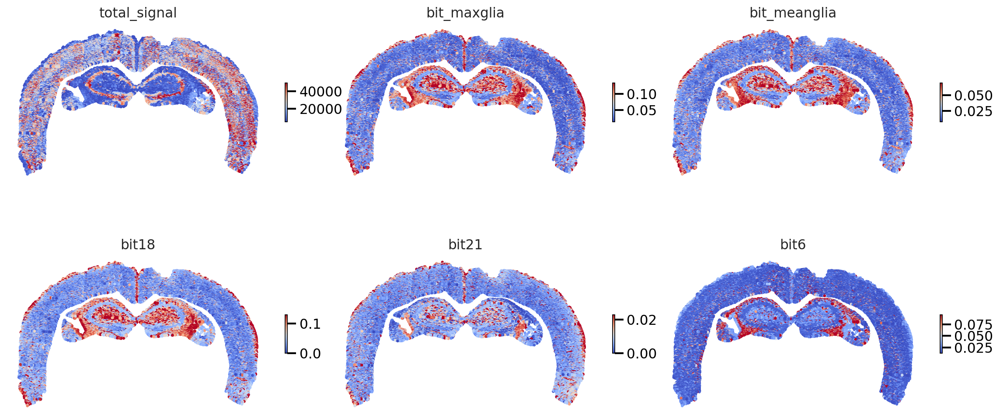

In [180]:

df = dfplot
cond = df['dataset']=='dredFISH'
df = df[cond]
# hue_cols = ['bit18', 'bit21', 'bit6', 'bit_nonneu']
hue_cols = [ 
            'total_signal', 'bit_maxglia', 'bit_meanglia', 
            'bit18', 'bit21', 'bit6',
           ]

fig, axs = plt.subplots(2,3, figsize=(6*3, 4*2))
for ax, hue_col in zip(axs.flat, hue_cols):
    g = ax.scatter(df['coord_x'].values, 
               df['coord_y'].values,
               c=basicu.clip_by_percentile(df[hue_col].values),
               cmap='coolwarm',
               s=2,
              )
    ax.set_title(hue_col)
    ax.grid(False)
    ax.axis('off')
    ax.invert_yaxis()
    ax.set_aspect('equal')
    fig.colorbar(g, ax=ax, shrink=0.2)

fig.subplots_adjust(wspace=0)
plt.show()

In [197]:
data

AnnData object with n_obs × n_vars = 44075 × 24
    obs: 'label', 'pixel_x', 'pixel_y', 'nuclei_size', 'nuclei_signal', 'cytoplasm_size', 'cytoplasm_signal', 'total_size', 'total_signal', 'posname', 'posname_stage_x', 'posname_stage_y', 'cell_name', 'stage_x', 'stage_y', 'coord_x', 'coord_y', 'region_id', 'region_color', 'region_acronym', 'Level_1_class_label', 'Level_2_neighborhood_label', 'Level_3_subclass_label'
    obsm: 'stage'
    layers: 'cytoplasm_vectors', 'nuclei_vectors', 'total_vectors', 'norm_cell'

<AxesSubplot:ylabel='Count'>

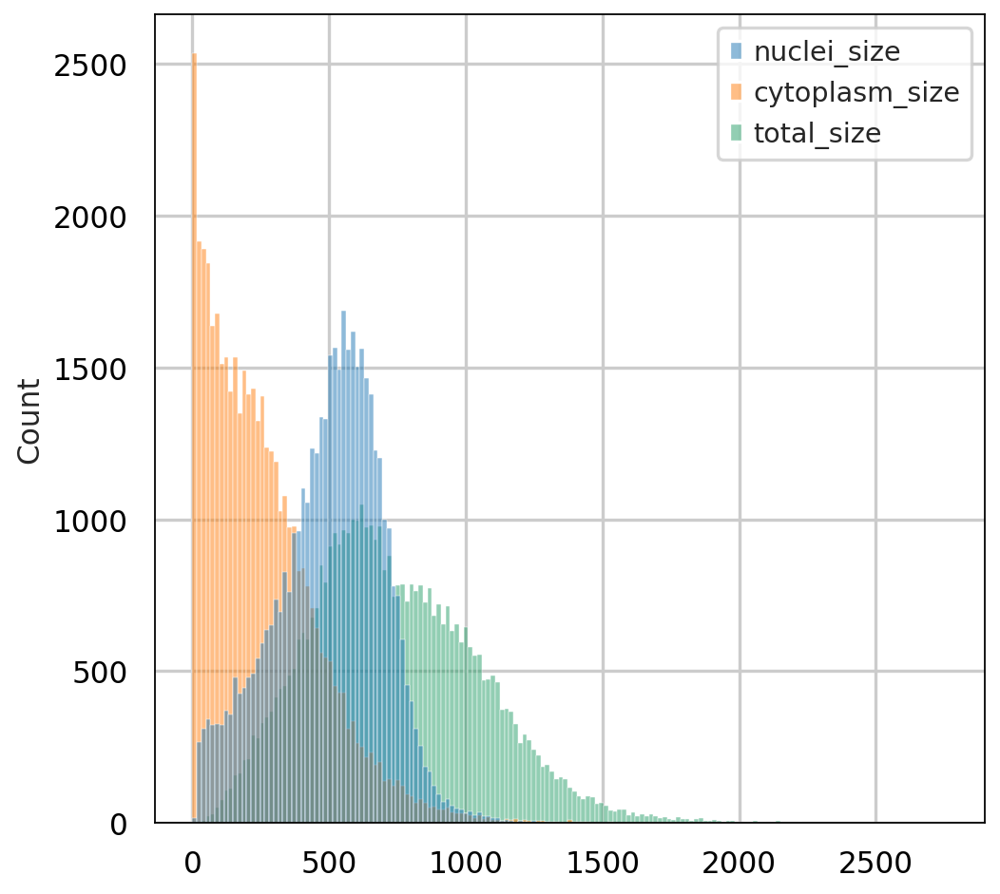

In [206]:
sns.histplot(data=data.obs.filter(regex='_size$', axis=1)
            )

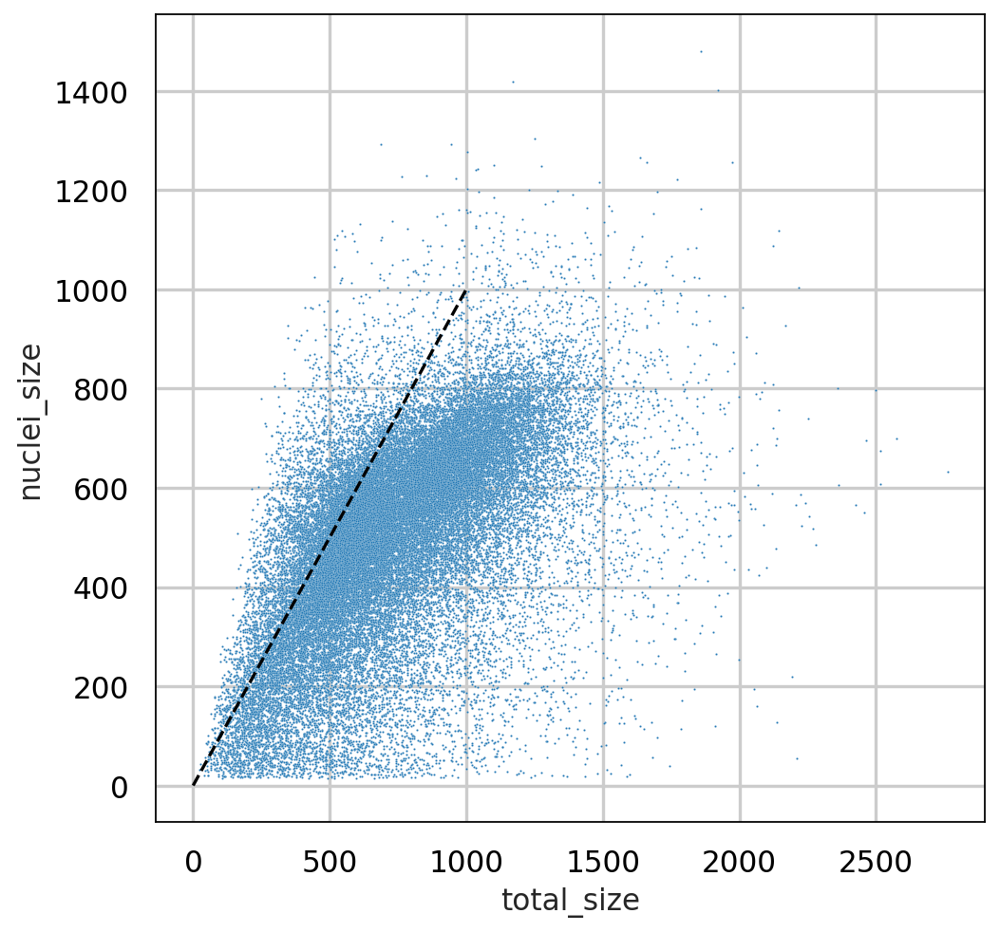

In [216]:
sns.scatterplot(data=data.obs, #.filter(regex='_size$', axis=1),
                x='total_size',
                y='nuclei_size',
                s=1,
            )
plt.plot([0,1000], [0,1000], color='k', linestyle='--')

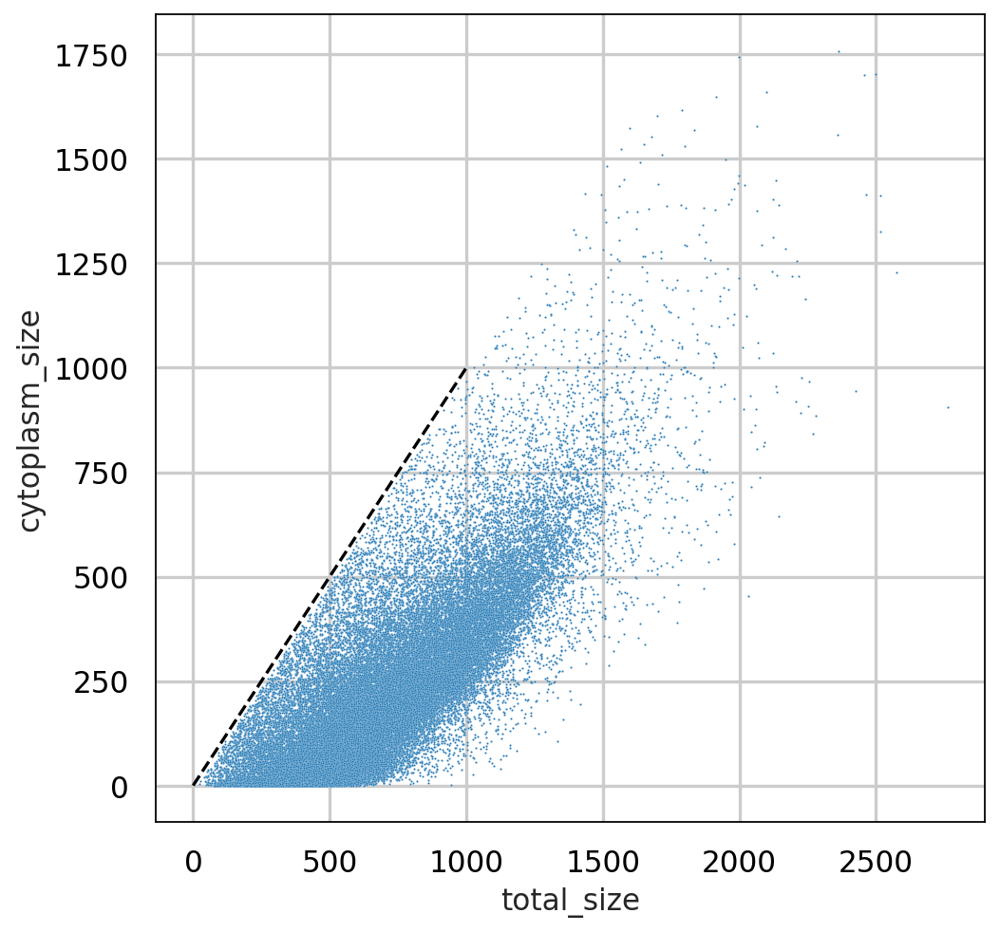

In [217]:
sns.scatterplot(data=data.obs, #.filter(regex='_size$', axis=1),
                x='total_size',
                y='cytoplasm_size',
                s=1,
            )
plt.plot([0,1000], [0,1000], color='k', linestyle='--')

/tmp/ipykernel_2492363/3652475546.py:22: MatplotlibDeprecationWarning:

Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.



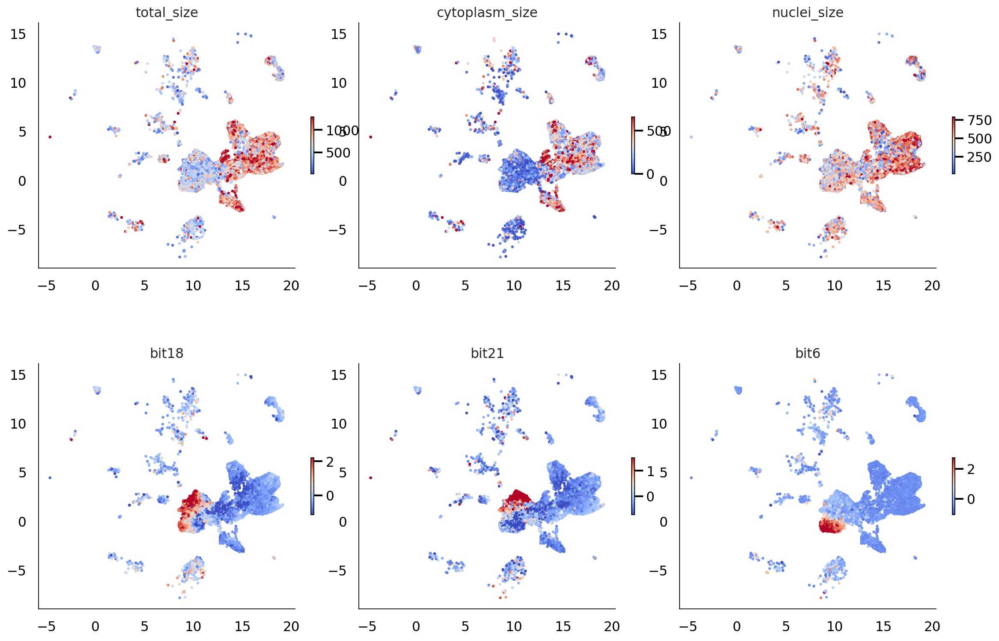

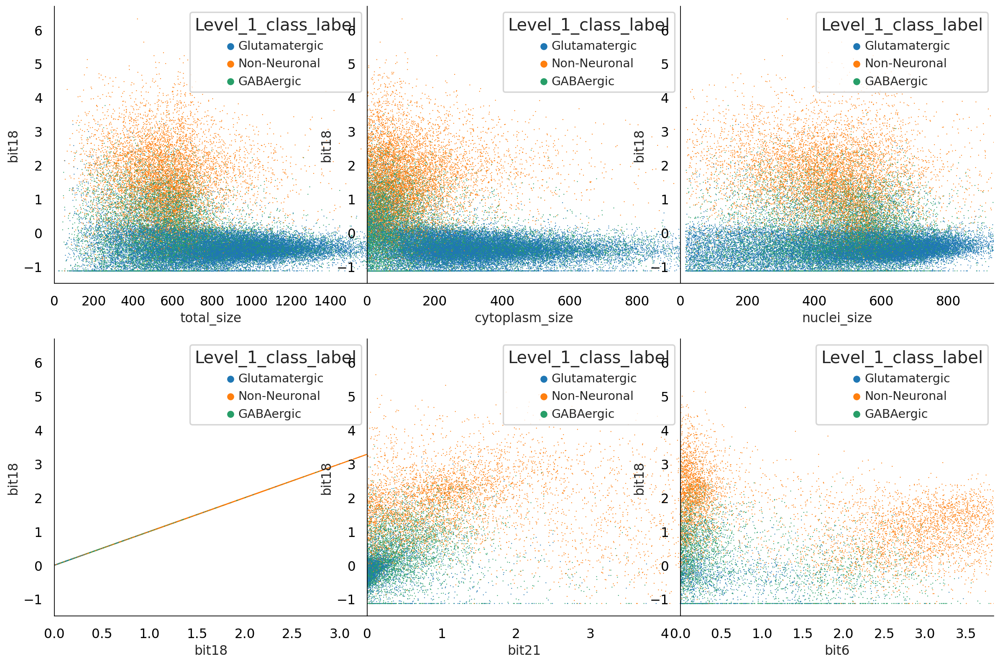

In [222]:
df = dfplot
cond = df['dataset']=='dredFISH'
df = df[cond]
hue_cols = [
            'total_size', 'cytoplasm_size', 'nuclei_size', 
            'bit18', 'bit21', 'bit6',
           
           ]

fig, axs = plt.subplots(2,3, figsize=(6*3, 6*2))
for ax, hue_col in zip(axs.flat, hue_cols):
    g = ax.scatter(df['embed_1'].values, 
               df['embed_2'].values,
               c=basicu.clip_by_percentile(np.nan_to_num(df[hue_col].values, 0), low_p=0, high_p=95),
               cmap='coolwarm',
               s=2,
              )
    ax.set_title(hue_col)
    ax.grid(False)
    sns.despine(ax=ax)
    ax.set_aspect('equal')
    fig.colorbar(g, ax=ax, shrink=0.2)

# ax = axs[1]
# evalu.plot_embed(ax, df[cond], 'bit18')
# # plot_highlight(ax, df, 'dataset', 'dredFISH', 'C0')
# # ax = axs[2]
# # plot_highlight(ax, df, 'dataset', 'scRNA-seq', 'C1')
fig.subplots_adjust(wspace=0)
plt.show()

# df = dfplot
# cond = df['dataset']=='dredFISH'
# df = df[cond]
# x_cols = ['bit_maxglia', 'bit_meanglia', 'bit_medianglia', 
#             'bit18', 'bit21', 'bit6',
#            ]
x_cols = hue_cols

fig, axs = plt.subplots(2,3, figsize=(6*3, 6*2))
for ax, x_col in zip(axs.flat, x_cols):
    sns.scatterplot(data=df,
                    x=x_col, 
                    y='bit18',
                    hue='Level_1_class_label',
                    edgecolor='none',
                    s=1,
                    ax=ax,
                   )
    ax.grid(False)
    sns.despine(ax=ax)
    hi_val = np.percentile(df[x_col].values, 99)
    ax.set_xlim([0, hi_val])
fig.subplots_adjust(wspace=0)
plt.show()